In [8]:
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import HTML, display
from matplotlib.animation import FuncAnimation
import pywt
import coherence_utils as c_utils

In [2]:
ticksize = 12
fontsize = 15

Load shot gathers from the two different velocity gather_vms

In [4]:
gather_vm1 = np.load('data/shot35_Vmodel1.npy')
gather_vm2 = np.load('data/shot35_Vmodel2.npy')

Display shot gathers

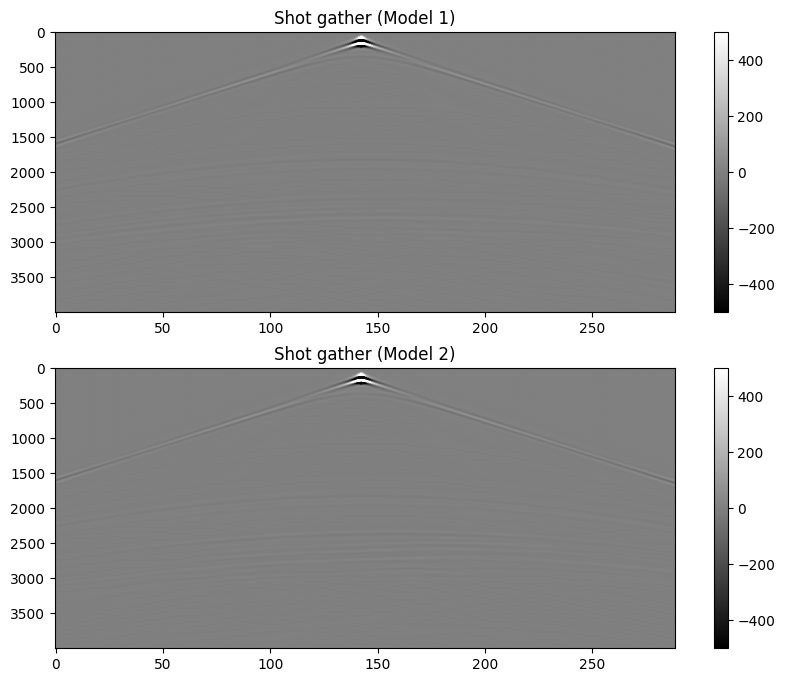

In [84]:
plt.figure(figsize=(10, 8))
plt.subplot(211)
plt.imshow(gather_vm1, cmap='gray', aspect='auto', vmin=-500, vmax=500)
plt.title('Shot gather (Model 1)')
plt.colorbar()
plt.subplot(212)
plt.imshow(gather_vm2, cmap='gray', aspect='auto', vmin=-500, vmax=500)
plt.title('Shot gather (Model 2)')
plt.colorbar()

Do a wavelet decomposition and inspect how the various levels look like for the two shot gathers

In [85]:
# Define the wavelet and decomposition level
wavelet = 'haar'  # You can choose a different wavelet, haar
level = 3  # Number of decomposition levels

# data to use
pdata = gather_vm1
# Perform 2D wavelet decomposition
coeffs = pywt.wavedec2(pdata, wavelet, level=level)

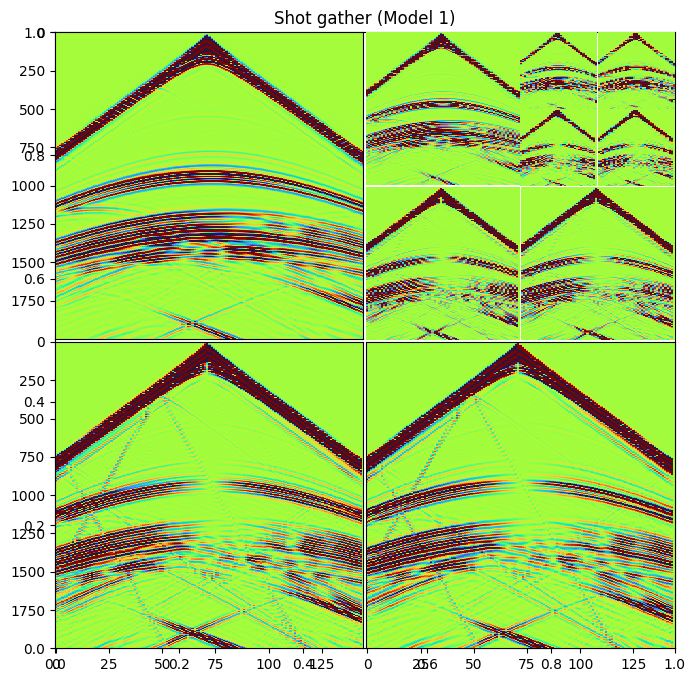

In [86]:
level_rows = int(2**level)
color_map = "turbo" #CMAP
plt.figure(figsize=(level_rows, level_rows))
plt.title("Shot gather (Model 1)")
ax1 = plt.subplot(level_rows,level_rows,level_rows)
ax1.axis('equal')
# plt.imshow(coeffs[0], cmap=color_map)
plt.imshow(coeffs[0], cmap=color_map, 
           vmin=-np.percentile(np.absolute(coeffs[0]),90), 
           vmax=np.percentile(np.absolute(coeffs[0]),90), aspect='auto', interpolation='none')
ax1.axis("off")
for i in range(1,level+1):
    ax1 = plt.subplot(level_rows,level_rows,level_rows-1)
    ax1.axis('equal')
    # plt.imshow(coeffs[i][0], cmap=color_map)
    plt.imshow(coeffs[i][0], cmap=color_map, 
           vmin=-np.percentile(np.absolute(coeffs[i][0]),90), 
           vmax=np.percentile(np.absolute(coeffs[i][0]),90), aspect='auto', interpolation='none')
    if i != level:
        ax1.axis('off')
    else:
        ax1.xaxis.set_visible(False) 
    ax1 = plt.subplot(level_rows,level_rows,2*level_rows-1)
    ax1.axis('equal')
    # plt.imshow(coeffs[i][2], cmap=color_map)
    plt.imshow(coeffs[i][2], cmap=color_map, 
           vmin=-np.percentile(np.absolute(coeffs[i][2]),90), 
           vmax=np.percentile(np.absolute(coeffs[i][2]),90), aspect='auto', interpolation='none')
    if i != level:
        ax1.axis('off')
    ax1 = plt.subplot(level_rows,level_rows,2*level_rows)
    ax1.axis('equal')
    # plt.imshow(coeffs[i][1], cmap=color_map)
    plt.imshow(coeffs[i][1], cmap=color_map, 
           vmin=-np.percentile(np.absolute(coeffs[i][1]),90), 
           vmax=np.percentile(np.absolute(coeffs[i][1]),90), aspect='auto', interpolation='none')
        #    extent=(0,len(pdata[0])/samples_per_sec, start_ch, start_ch + nchannels))
    if i != level:
        ax1.axis('off')
    else:
        ax1.yaxis.set_visible(False) 
    level_rows = int(level_rows/2)
plt.subplots_adjust(wspace=0.01, hspace=0.01)

In [33]:
# data to use
pdata = gather_vm2
# Perform 2D wavelet decomposition
coeffs = pywt.wavedec2(pdata, wavelet, level=level)

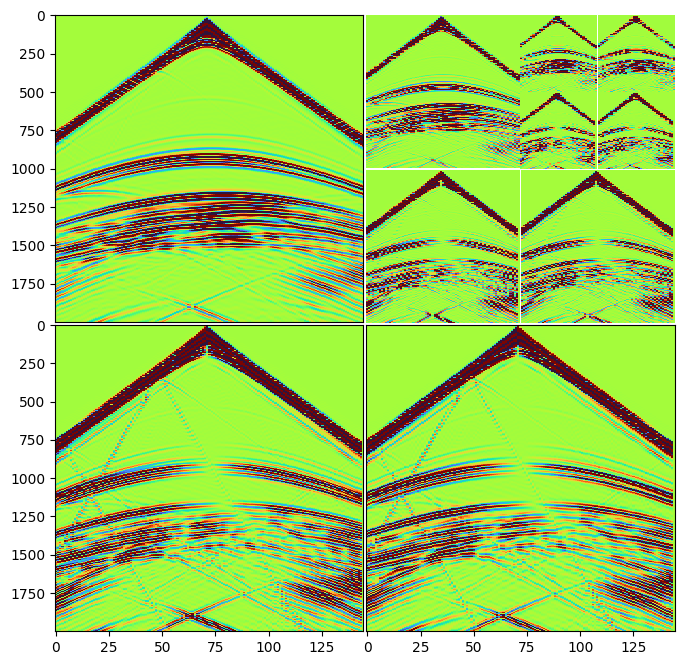

In [34]:
level_rows = int(2**level)
color_map = "turbo" #CMAP
plt.figure(figsize=(level_rows, level_rows))
plt.title("Shot gather (Model 2)")
ax1 = plt.subplot(level_rows,level_rows,level_rows)
ax1.axis('equal')
# plt.imshow(coeffs[0], cmap=color_map)
plt.imshow(coeffs[0], cmap=color_map, 
           vmin=-np.percentile(np.absolute(coeffs[0]),90), 
           vmax=np.percentile(np.absolute(coeffs[0]),90), aspect='auto', interpolation='none')
ax1.axis("off")
for i in range(1,level+1):
    ax1 = plt.subplot(level_rows,level_rows,level_rows-1)
    ax1.axis('equal')
    # plt.imshow(coeffs[i][0], cmap=color_map)
    plt.imshow(coeffs[i][0], cmap=color_map, 
           vmin=-np.percentile(np.absolute(coeffs[i][0]),90), 
           vmax=np.percentile(np.absolute(coeffs[i][0]),90), aspect='auto', interpolation='none')
    if i != level:
        ax1.axis('off')
    else:
        ax1.xaxis.set_visible(False) 
    ax1 = plt.subplot(level_rows,level_rows,2*level_rows-1)
    ax1.axis('equal')
    # plt.imshow(coeffs[i][2], cmap=color_map)
    plt.imshow(coeffs[i][2], cmap=color_map, 
           vmin=-np.percentile(np.absolute(coeffs[i][2]),90), 
           vmax=np.percentile(np.absolute(coeffs[i][2]),90), aspect='auto', interpolation='none')
    if i != level:
        ax1.axis('off')
    ax1 = plt.subplot(level_rows,level_rows,2*level_rows)
    ax1.axis('equal')
    # plt.imshow(coeffs[i][1], cmap=color_map)
    plt.imshow(coeffs[i][1], cmap=color_map, 
           vmin=-np.percentile(np.absolute(coeffs[i][1]),90), 
           vmax=np.percentile(np.absolute(coeffs[i][1]),90), aspect='auto', interpolation='none')
        #    extent=(0,len(pdata[0])/samples_per_sec, start_ch, start_ch + nchannels))
    if i != level:
        ax1.axis('off')
    else:
        ax1.yaxis.set_visible(False) 
    level_rows = int(level_rows/2)
plt.subplots_adjust(wspace=0.01, hspace=0.01)

In [88]:
# data to use
pdata = gather_vm2 - gather_vm1
# Perform 2D wavelet decomposition
coeffs = pywt.wavedec2(pdata, wavelet, level=level)

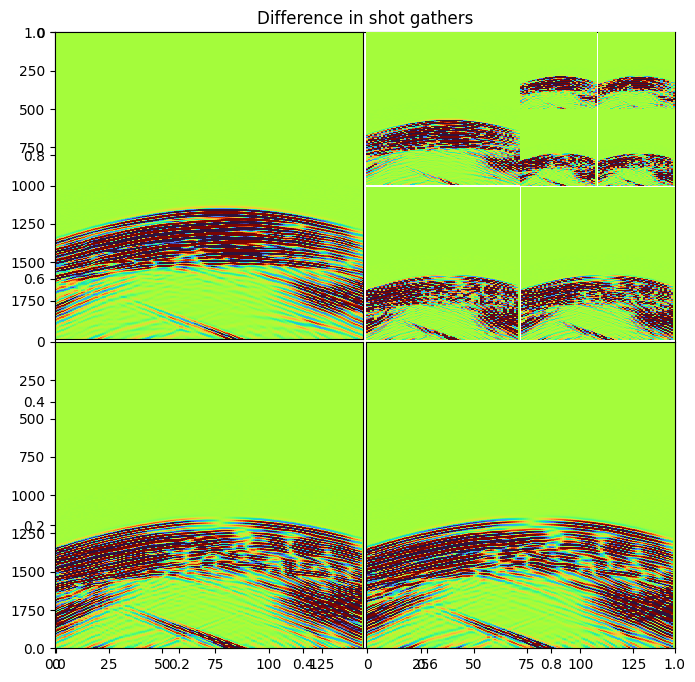

In [89]:
level_rows = int(2**level)
color_map = "turbo" #CMAP
plt.figure(figsize=(level_rows, level_rows))
plt.title("Difference in shot gathers")
ax1 = plt.subplot(level_rows,level_rows,level_rows)
ax1.axis('equal')
# plt.imshow(coeffs[0], cmap=color_map)
plt.imshow(coeffs[0], cmap=color_map, 
           vmin=-np.percentile(np.absolute(coeffs[0]),90), 
           vmax=np.percentile(np.absolute(coeffs[0]),90), aspect='auto', interpolation='none')
ax1.axis("off")
for i in range(1,level+1):
    ax1 = plt.subplot(level_rows,level_rows,level_rows-1)
    ax1.axis('equal')
    # plt.imshow(coeffs[i][0], cmap=color_map)
    plt.imshow(coeffs[i][0], cmap=color_map, 
           vmin=-np.percentile(np.absolute(coeffs[i][0]),90), 
           vmax=np.percentile(np.absolute(coeffs[i][0]),90), aspect='auto', interpolation='none')
    if i != level:
        ax1.axis('off')
    else:
        ax1.xaxis.set_visible(False) 
    ax1 = plt.subplot(level_rows,level_rows,2*level_rows-1)
    ax1.axis('equal')
    # plt.imshow(coeffs[i][2], cmap=color_map)
    plt.imshow(coeffs[i][2], cmap=color_map, 
           vmin=-np.percentile(np.absolute(coeffs[i][2]),90), 
           vmax=np.percentile(np.absolute(coeffs[i][2]),90), aspect='auto', interpolation='none')
    if i != level:
        ax1.axis('off')
    ax1 = plt.subplot(level_rows,level_rows,2*level_rows)
    ax1.axis('equal')
    # plt.imshow(coeffs[i][1], cmap=color_map)
    plt.imshow(coeffs[i][1], cmap=color_map, 
           vmin=-np.percentile(np.absolute(coeffs[i][1]),90), 
           vmax=np.percentile(np.absolute(coeffs[i][1]),90), aspect='auto', interpolation='none')
        #    extent=(0,len(pdata[0])/samples_per_sec, start_ch, start_ch + nchannels))
    if i != level:
        ax1.axis('off')
    else:
        ax1.yaxis.set_visible(False) 
    level_rows = int(level_rows/2)
plt.subplots_adjust(wspace=0.01, hspace=0.01)

Text(0.5, 1.0, 'Difference in shot gathers')

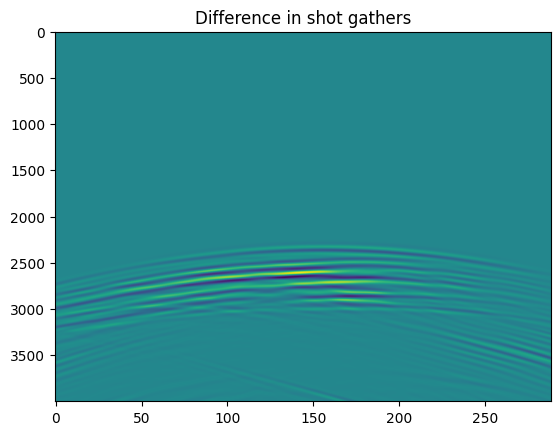

In [90]:
plt.imshow(pdata, aspect='auto')
plt.title("Difference in shot gathers")

We have considered the decompsition of the two shot gathers and the decomposition of their difference above. In the next cells we look at the difference betweeen the shot gathers in the wavelet domain. We test out different wavelets.

In [92]:
# Define the wavelet and decomposition level
wavelet = 'bior1.1'  # You can choose a different wavelet, haar, bior1.1, db3
level = 3  # Number of decomposition levels

# data to use
pdata1 = gather_vm1
pdata2 = gather_vm2
# Perform 2D wavelet decomposition
coeffs1 = pywt.wavedec2(pdata1, wavelet, level=level)
coeffs2 = pywt.wavedec2(pdata2, wavelet, level=level)

print(gather_vm1.shape)
coeffs1[0].shape

(4000, 289)


(500, 37)

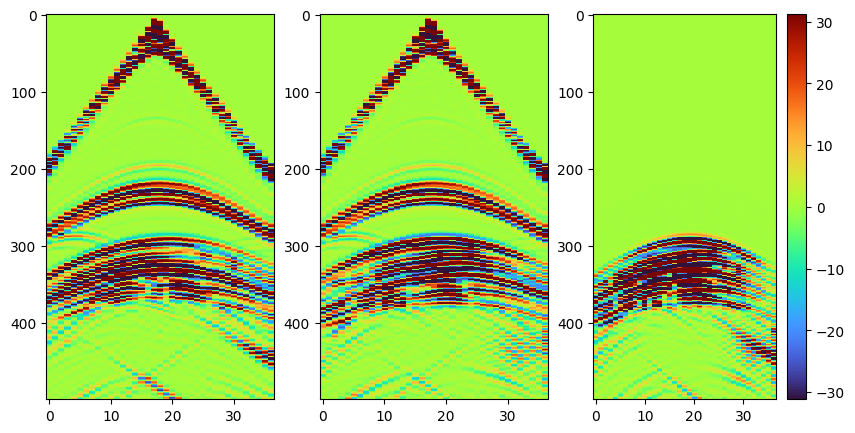

In [93]:
# plt.figure(figsize=(10,5))
# plt.subplot(131)
# plt.imshow(coeffs1[level][0], cmap=color_map, 
#            vmin=-np.percentile(np.absolute(coeffs1[level][0]),90), 
#            vmax=np.percentile(np.absolute(coeffs1[level][0]),90), aspect='auto', interpolation='none')
# plt.subplot(132)
# plt.imshow(coeffs2[level][0], cmap=color_map, 
#            vmin=-np.percentile(np.absolute(coeffs2[level][0]),90), 
#            vmax=np.percentile(np.absolute(coeffs1[level][0]),90), aspect='auto', interpolation='none')
# plt.subplot(133)
# plt.imshow(coeffs1[level][0] - coeffs2[level][0], cmap=color_map, 
#            vmin=-np.percentile(np.absolute(coeffs1[level][0]),90), 
#            vmax=np.percentile(np.absolute(coeffs1[level][0]),90), aspect='auto', interpolation='none')
# plt.colorbar()

plt.figure(figsize=(10,5))
plt.subplot(131)
plt.imshow(coeffs1[0], cmap=color_map, 
           vmin=-np.percentile(np.absolute(coeffs1[0]),90), 
           vmax=np.percentile(np.absolute(coeffs1[0]),90), aspect='auto', interpolation='none')
plt.subplot(132)
plt.imshow(coeffs2[0], cmap=color_map, 
           vmin=-np.percentile(np.absolute(coeffs2[0]),90), 
           vmax=np.percentile(np.absolute(coeffs2[0]),90), aspect='auto', interpolation='none')
plt.subplot(133)
plt.imshow(coeffs1[0] - coeffs2[0], cmap=color_map, 
           vmin=-np.percentile(np.absolute(coeffs1[0]),90), 
           vmax=np.percentile(np.absolute(coeffs1[0]),90), aspect='auto', interpolation='none')
plt.colorbar()

### Investigate how well we can use coherence analysis to summarize this data

In [16]:
gather_vm1.shape

(4000, 289)

In [5]:
nsensors = gather_vm1.shape[1]

In [17]:
data = gather_vm1.T
sample_interval = 0.001
overlap = 0
subwindow_len = 0.5
coherence_mat, frequencies = c_utils.welch_coherence(data, subwindow_len = subwindow_len, overlap = overlap, sample_interval=sample_interval)

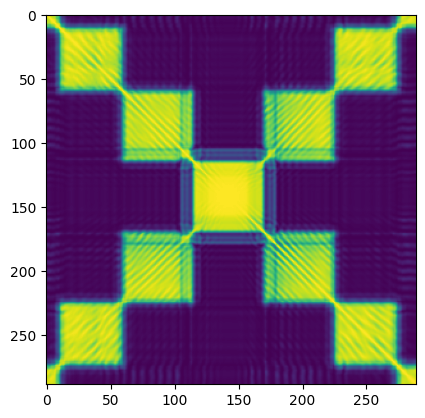

In [20]:
plt.imshow(coherence_mat[10])
# coherence_mat.shape

Animation size has reached 21344667 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


<Figure size 600x600 with 0 Axes>

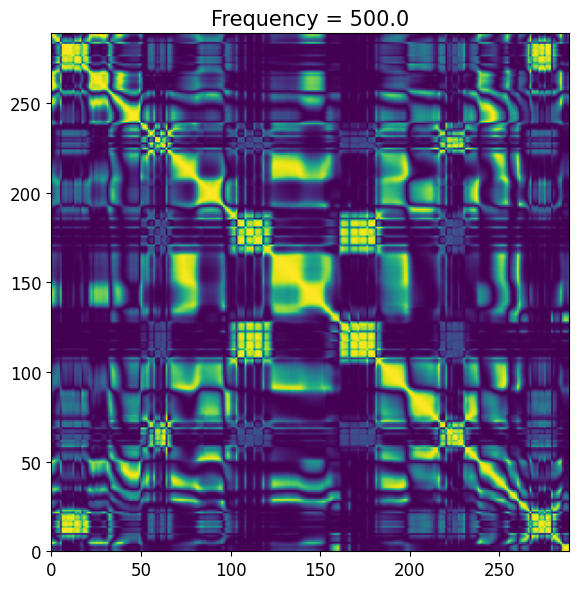

In [19]:
# Create two 3D arrays (example data)
num_frames = len(coherence_mat)  # 30
data1 = coherence_mat[:]  # Replace with your 3D data array 1

# Create a function to update the animations
fig = plt.figure(figsize=(6, 6))


def update(frame):
    fig.clear()

    # Update the first animation
    ax = fig.add_subplot(111)
    ax.imshow(
        # data1[:, :, frame],
        data1[frame],
        cmap=plt.cm.viridis,
        animated=True,
        extent=[0, nsensors, 0, nsensors],
    )  # ,  vmin=-np.percentile(abs(data1[frame]),90), vmax=np.percentile(abs(data1[frame]),90))
    # ax.imshow(data1[frame], cmap=plt.cm.viridis, animated=True,  vmin=-epsilon, vmax=epsilon)
    ax.set_title("Frequency = " + str(frequencies[frame]), size=fontsize)

    plt.xticks(fontsize=ticksize)
    plt.yticks(fontsize=ticksize)
    plt.tight_layout()


# Create the animations
fig = plt.figure(figsize=(6, 6))
ani = FuncAnimation(fig, update, frames=num_frames, repeat=False)

# Display the animations side by side
display(HTML(ani.to_jshtml()))

# Alternatively, you can save the animations as video files
# ani.save('Coherence_mat.gif', writer='imagemagick')